In [2]:

import os
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt

path = os.path.join(os.path.abspath(''), "la-haute-borne-data-2017-2020.csv")
d = pd.read_csv(path)

In [3]:
# Setup Variables
variables = ["Ba_avg", "Ws_avg", "Ds_avg", "Rm_avg", "Ot_avg"]
additional_data = ["Wind_turbine_name", "Date_time", "P_avg"]

variables.extend(additional_data)
data = d[variables]
variables = [v for v in variables if v not in additional_data]

# Remove any data points which are not the same wind turbine
data = data.query('(Wind_turbine_name == "R80790")')

# Remove any rows which contain missing values
data = data.replace("", np.nan)

# Convert date column to datetime object
data["Date_time"] = pd.to_datetime(data["Date_time"], format="%Y-%m-%d %H:%M:%S%z")

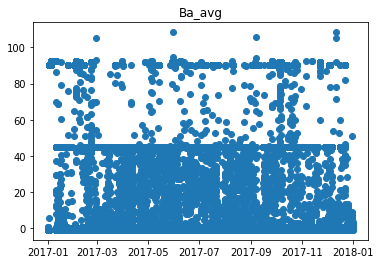

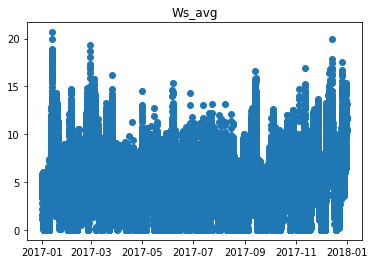

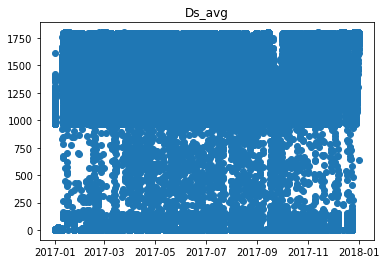

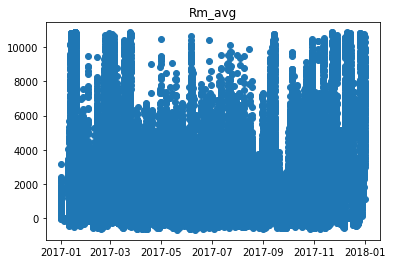

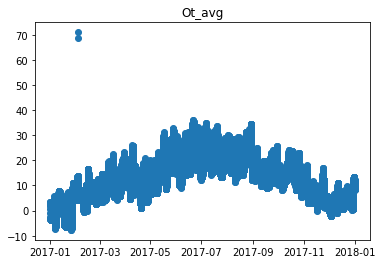

In [5]:
%matplotlib inline

for i, parameter in enumerate(variables):
    plt.figure(num=i)
    plt.title(parameter)
    plt.scatter(data["Date_time"], data[variables[i]])

In [ ]:
for i, parameter in enumerate(variables):
    plt.figure(num=i)
    plt.title(f"{parameter}")
    plt.hexbin(data["P_avg"], data[variables[i]])